![Bitcoin Image](images/example.png)

In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf
from plotly.subplots import make_subplots
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.stattools import pacf
from itertools import cycle
from plotly.subplots import make_subplots
from datetime import datetime

import statsmodels.api as sm


### Data Exploration

In this section we just explore the Data i.e the Historic Bitcoin Prices and try to find some insights. 

In [2]:
# read in our dataset
main_df = pd.read_csv('data/btc_price_hourly_data_2013-05-01_2019-11-01.csv')
main_df.head()

,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
0,2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726
1,2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839
2,2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368
3,2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349
4,2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413


Volume_(BTC) - This column represents the total trading volume of Bitcoin during a specific time period, measured in units of Bitcoin.
Volume_(Currency) - This column represents the equivalent trading volume of Bitcoin, but measured in a specific currency(USD).
Weighted_Price - This column represents the weighted average price of Bitcoin during a specific time period. This value is calculated by considering the average price of Bitcoin transactions, weighted by their corresponding trading volumes.

In [692]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57001 entries, 0 to 57000
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Timestamp          57001 non-null  object 
 1   Open               56889 non-null  float64
 2   High               56889 non-null  float64
 3   Low                56889 non-null  float64
 4   Close              56889 non-null  float64
 5   Volume_(BTC)       56889 non-null  float64
 6   Volume_(Currency)  56889 non-null  float64
 7   Weighted_Price     56889 non-null  float64
dtypes: float64(7), object(1)
memory usage: 3.5+ MB


In [693]:
main_df.isna().sum()

Timestamp              0
Open                 112
High                 112
Low                  112
Close                112
Volume_(BTC)         112
Volume_(Currency)    112
Weighted_Price       112
dtype: int64

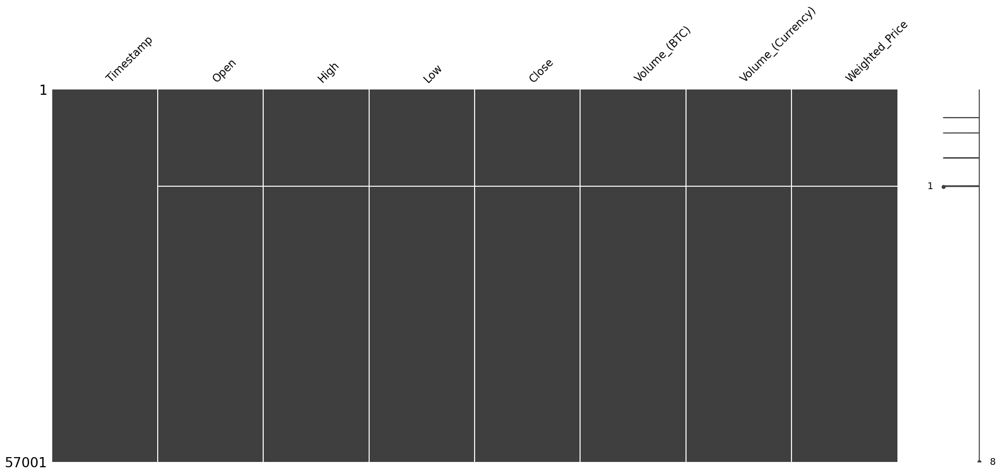

In [694]:
msno.matrix(main_df)
plt.show()

 This graph generates a matrix visualization where each row represents a variable, and each column represents an observation. The white lines or blocks in the rows indicate missing values for that particular variable across different observations.

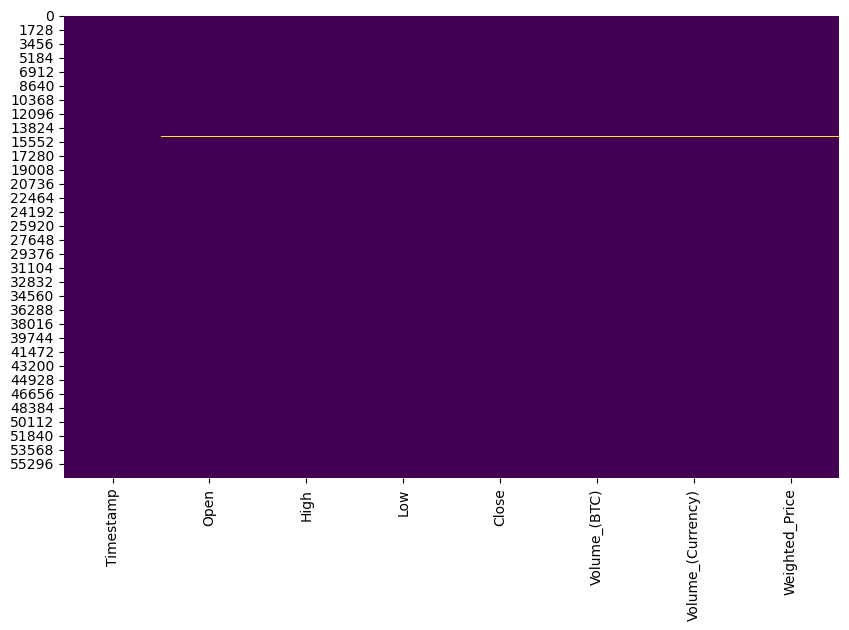

In [695]:
plt.figure(figsize=(10, 6))
sns.heatmap(main_df.isnull(), cbar=False, cmap='viridis')
plt.show()

In [696]:
rows_with_missing_values = main_df[main_df.isnull().any(axis=1)]
rows_with_missing_values.head(112)

,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
4304,2013-10-27 08:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4305,2013-10-27 09:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4306,2013-10-27 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6658,2014-02-02 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10469,2014-07-11 05:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
14848,2015-01-09 16:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14849,2015-01-09 17:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14850,2015-01-09 18:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14851,2015-01-09 19:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


A temporal pattern in the missing values is identified since the missing data is mostly from 2015-01-05 10hrs to 2015-01-09 20hrs

In [697]:
main_df.describe()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
count,56889.000000,56889.000000,56889.000000,56889.000000,56889.000000,5.688900e+04,56889.000000
mean,2934.381088,2936.523542,2932.009529,2934.321859,9.370423,2.407323e+04,2934.261645
std,3706.983918,3710.367821,3703.148664,3706.876075,12.696851,5.170120e+04,3706.787680
min,64.593208,64.826038,64.413585,64.631509,0.066982,1.931271e+01,64.573295
25%,374.703750,374.891778,374.408393,374.662927,3.001213,1.787506e+03,374.671284
50%,677.398077,677.745862,676.972281,677.358846,5.659669,5.655829e+03,677.340604
75%,5282.904500,5285.376500,5279.070566,5282.882982,10.752931,2.302096e+04,5283.299203
max,19572.812500,19581.942500,19548.541667,19570.349667,342.520851,1.289861e+06,19565.549694


In [698]:
main_df = main_df[~((main_df['Timestamp'] >= '2015-01-05 10:00:00') & (main_df['Timestamp'] <= '2015-01-09 20:00:00'))]
main_df.isna().sum()

Timestamp            0
Open                 5
High                 5
Low                  5
Close                5
Volume_(BTC)         5
Volume_(Currency)    5
Weighted_Price       5
dtype: int64

In [699]:
main_df.fillna(method='bfill', inplace=True)
main_df.isna().sum()

Timestamp            0
Open                 0
High                 0
Low                  0
Close                0
Volume_(BTC)         0
Volume_(Currency)    0
Weighted_Price       0
dtype: int64

### EDA(Exploratory Data Analysis)

In [700]:
# Printing the start date and End date of the dataset
start_date = main_df.iloc[0][0]
end_date = main_df.iloc[-1][0]


print('Starting Date',start_date)
print('Ending Date',end_date)

Starting Date 2013-05-01 00:00:00
Ending Date 2019-11-01 00:00:00


### Correlation Analysis:

Explore the relationships between different variables using correlation matrices

In [701]:
numeric_columns = main_df.select_dtypes(include='float')
correlation_matrix = numeric_columns.corr()
correlation_matrix

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
Open,1.000000,1.000000,1.000000,1.000000,-0.072377,0.620316,1.000000
High,1.000000,1.000000,0.999999,1.000000,-0.072122,0.620753,1.000000
Low,1.000000,0.999999,1.000000,1.000000,-0.072655,0.619840,1.000000
Close,1.000000,1.000000,1.000000,1.000000,-0.072383,0.620309,1.000000
Volume_(BTC),-0.072377,-0.072122,-0.072655,-0.072383,1.000000,0.333988,-0.072397
Volume_(Currency),0.620316,0.620753,0.619840,0.620309,0.333988,1.000000,0.620282
Weighted_Price,1.000000,1.000000,1.000000,1.000000,-0.072397,0.620282,1.000000


In [702]:
main_df.columns

Index(['Timestamp', 'Open', 'High', 'Low', 'Close', 'Volume_(BTC)',
       'Volume_(Currency)', 'Weighted_Price'],
      dtype='object')

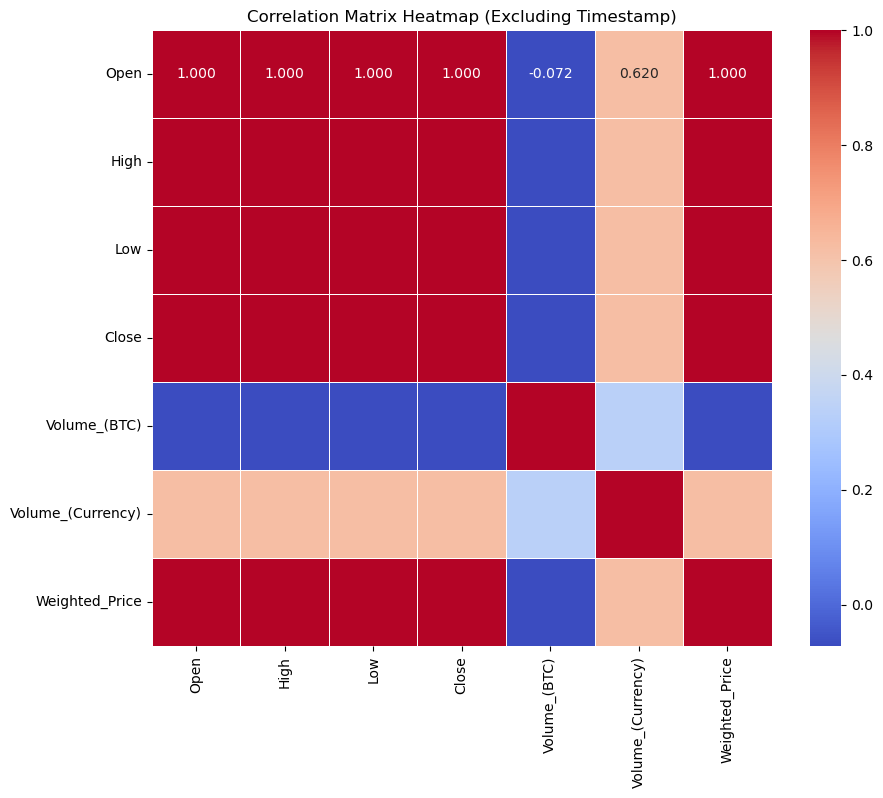

In [703]:
numeric_df = main_df.drop(columns=['Timestamp']).select_dtypes(include='number')
correlation_matrix = numeric_df.corr()

# Create a heatmap with correlation values annotated
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".3f", linewidths=.5)
plt.title('Correlation Matrix Heatmap (Excluding Timestamp)')
plt.show()

In [704]:
numeric_columns = main_df.select_dtypes(include='number')
numeric_columns.isnull().sum()

Open                 0
High                 0
Low                  0
Close                0
Volume_(BTC)         0
Volume_(Currency)    0
Weighted_Price       0
dtype: int64

In [705]:
main_df.columns

Index(['Timestamp', 'Open', 'High', 'Low', 'Close', 'Volume_(BTC)',
       'Volume_(Currency)', 'Weighted_Price'],
      dtype='object')

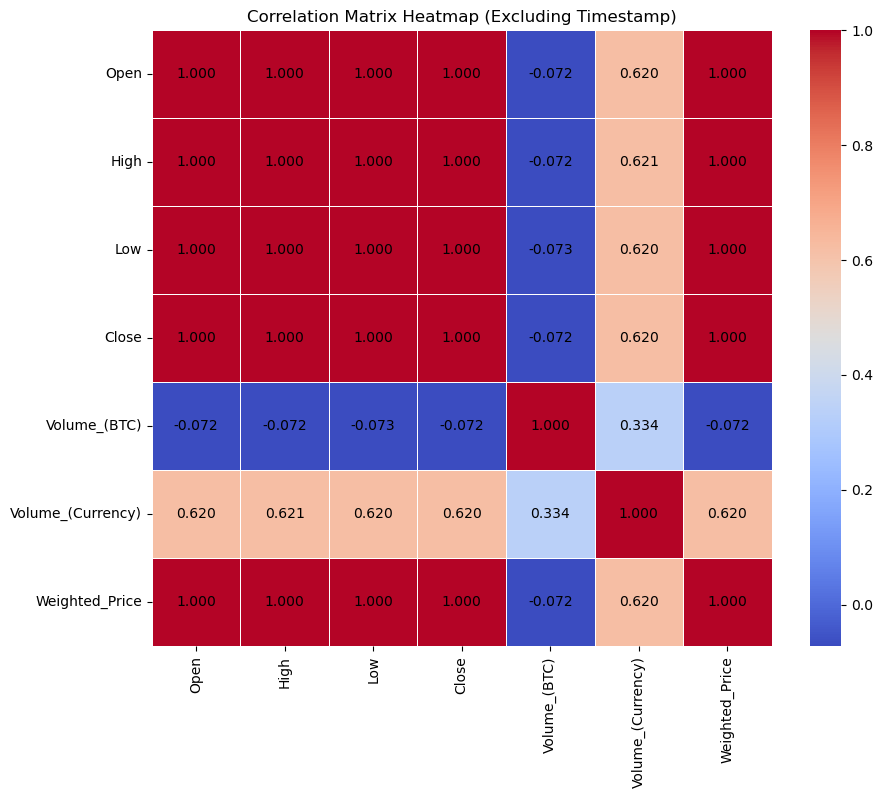

In [706]:
numeric_columns = main_df.drop(columns=['Timestamp']).select_dtypes(include='number')
correlation_matrix = numeric_columns.corr()

# Create a heatmap without automatic annotation
plt.figure(figsize=(10, 8))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', linewidths=.5)

# Manually annotate the heatmap with correlation values
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        text = f"{correlation_matrix.iloc[i, j]:.3f}"
        heatmap.text(j + 0.5, i + 0.5, text, ha='center', va='center', color='black')

plt.title('Correlation Matrix Heatmap (Excluding Timestamp)')
plt.show()

In [707]:
main_df.columns

Index(['Timestamp', 'Open', 'High', 'Low', 'Close', 'Volume_(BTC)',
       'Volume_(Currency)', 'Weighted_Price'],
      dtype='object')

In [708]:
# set the timestamp column as the index using main_df.set_index('Timestamp', inplace=True)
main_df['Timestamp'] = pd.to_datetime(main_df['Timestamp'])
main_df.set_index('Timestamp', inplace=True)

In [709]:
main_df.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume_(BTC)', 'Volume_(Currency)',
       'Weighted_Price'],
      dtype='object')

### Trend Analysis:
Plot the Time Series Data:

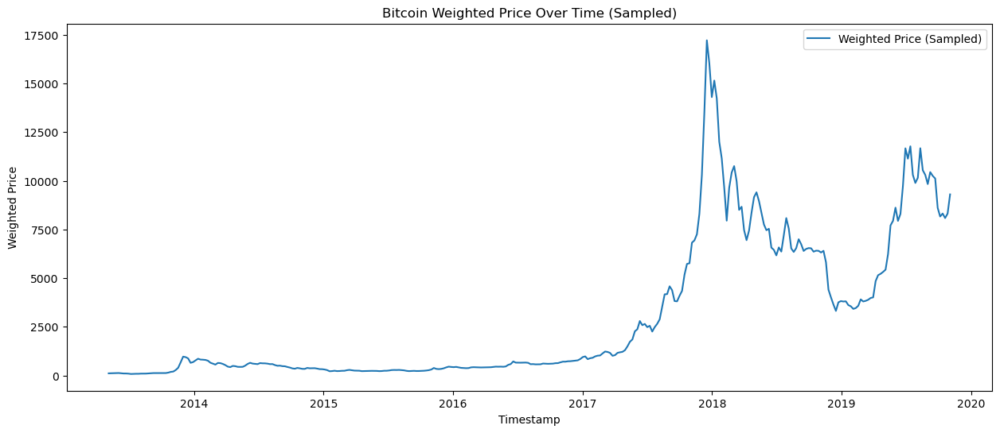

In [710]:

# Sample every Nth data point (adjust N based on your data size)
sampled_data = main_df['Weighted_Price'].resample('W').mean()  # Resample to weekly frequency, taking the mean/ Weekly average

# Create a time series plot for Bitcoin Weighted Price with weekly sampling
plt.figure(figsize=(15, 6))

# Plotting the 'Weighted_Price' against the timestamp (index)
plt.plot(sampled_data, label='Weighted Price (Sampled)')

# Adding title and axis labels
plt.title('Bitcoin Weighted Price Over Time (Sampled)')
plt.xlabel('Timestamp')
plt.ylabel('Weighted Price')

# Display legend
plt.legend()

# Show the plot
plt.show()

Looks like it would've been a good idea to buy Bitcoin back in 2016. :-)

### Create a plotting function
let's make a plotting function we can reuse later.

In [711]:
#to be formatted=======================================================================
# Create a function to plot time series data
def plot_time_series(timesteps, values, format='.', start=0, end=None, label=None):
  """
  Plots a timesteps (a series of points in time) against values (a series of values across timesteps).
  
  Parameters
  ---------
  timesteps : array of timesteps
  values : array of values across time
  format : style of plot, default "."
  start : where to start the plot (setting a value will index from start of timesteps & values)
  end : where to end the plot (setting a value will index from end of timesteps & values)
  label : label to show on plot of values
  """
  # Plot the series
  with plt.style.context('dark_background'):
      plt.plot(timesteps[start:end], values[start:end], format, label=label)
      plt.xlabel("Time")
      plt.ylabel("BTC Price")
      if label:
        plt.legend(fontsize=14) # make label bigger
      plt.grid(True)

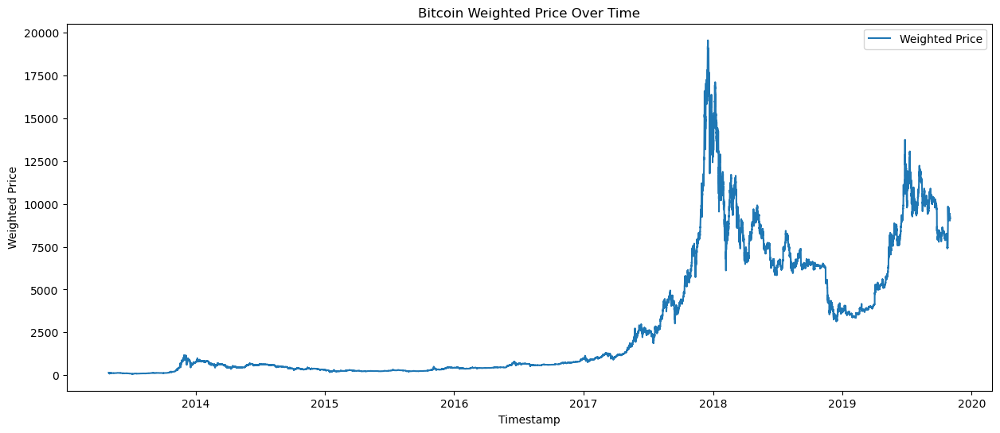

In [712]:
# Create a time series plot for Bitcoin Weighted Price
plt.figure(figsize=(15, 6))

# Plotting the 'Weighted_Price' against the timestamp (index)
plt.plot(main_df.index, main_df['Weighted_Price'], label='Weighted Price')

# Adding title and axis labels
plt.title('Bitcoin Weighted Price Over Time')
plt.xlabel('Timestamp')
plt.ylabel('Weighted Price')

# Display legend
plt.legend()

# Show the plot
plt.show()

Lets visualize Historical Bitcoin Market Volume (2013-2019)

In [713]:
# trace1 = go.Scatter(
#     x=main_df.index,  # Assuming 'Timestamp' is set as the index
#     y=main_df['Volume_(Currency)'].astype(float),
#     mode='lines',
#     name='Bitcoin Volume (USD)'
# )
max_volume = main_df['Volume_(Currency)'].max()

layout = dict(
    title='Historical Bitcoin Volume (USD) with Rangeslider',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1y',
                     step='month',
                     stepmode='backward'),
                dict(count=36,
                     label='3y',
                     step='month',
                     stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type='date',
        range=['2013-05-01 00:00:00', '2019-11-01 00:00:00']  
    ),
    yaxis=dict(
        range=[0, max_volume]  
    )
)

data = [trace1]

fig = make_subplots(rows=1, cols=1, shared_xaxes=True, subplot_titles=['Bitcoin Volume (USD)'])
fig.add_trace(trace1)
fig.update_layout(layout)

# Display the chart
fig.show()

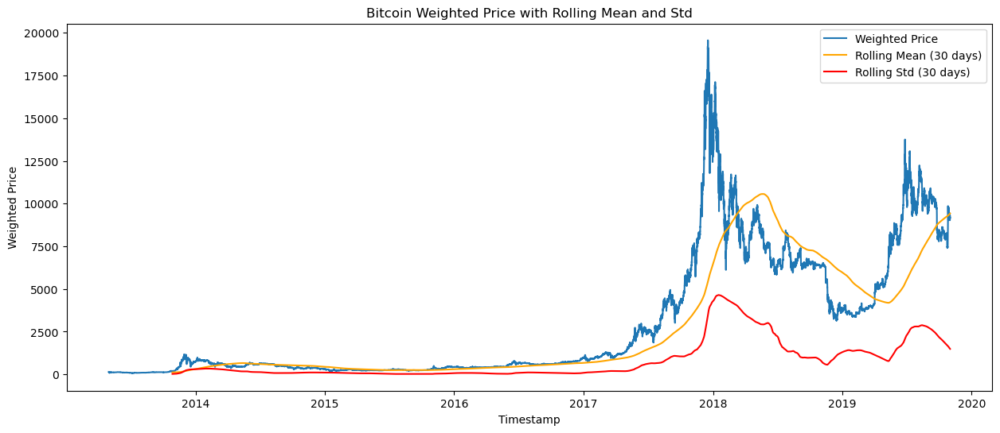

In [714]:
# Calculate the rolling mean and standard deviation
rolling_mean = main_df['Weighted_Price'].rolling(window=4320).mean()
rolling_std = main_df['Weighted_Price'].rolling(window=4320).std()

# Create a time series plot for Bitcoin Weighted Price with Rolling Mean and Std
plt.figure(figsize=(15, 6))

# Plotting the original 'Weighted_Price' time series
plt.plot(main_df['Weighted_Price'], label='Weighted Price')

# Plotting the Rolling Mean with a 30-day window
plt.plot(rolling_mean, label='Rolling Mean (30 days)', color='orange')

# Plotting the Rolling Standard Deviation with a 30-day window
plt.plot(rolling_std, label='Rolling Std (30 days)', color='red')

# Adding title and axis labels
plt.title('Bitcoin Weighted Price with Rolling Mean and Std')
plt.xlabel('Timestamp')
plt.ylabel('Weighted Price')

# Display legend
plt.legend()

# Show the plot
plt.show()

In [715]:
# Calculate the rolling mean and standard deviation
rolling_mean = main_df['Weighted_Price'].rolling(window=30).mean()
rolling_std = main_df['Weighted_Price'].rolling(window=30).std()

# Create a time series plot for Bitcoin Weighted Price with Rolling Mean and Std
fig = px.line(main_df, x=main_df.index, y='Weighted_Price', labels={'Weighted_Price': 'Weighted Price'}, title='Bitcoin Weighted Price with Rolling Mean and Std')

# Add Rolling Mean and Std to the plot
fig.add_scatter(x=main_df.index, y=rolling_mean, mode='lines', name='Rolling Mean (30 days)', line=dict(color='orange'))
fig.add_scatter(x=main_df.index, y=rolling_std, mode='lines', name='Rolling Std (30 days)', line=dict(color='red'))

# Show the interactive plot
fig.show()

In [716]:
main_df.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
Timestamp,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413


In [718]:
main_df.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
Timestamp,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413


### Seasonality Detection:

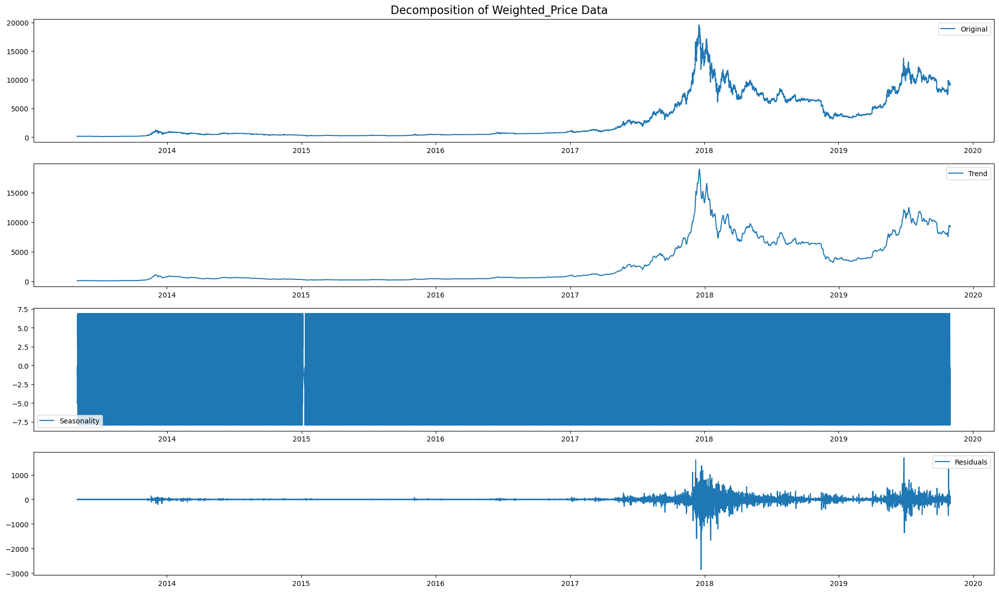

In [721]:
# 'Weighted_Price' is the column I want to decompose
data = main_df[['Weighted_Price']]

# Perform seasonal decomposition
decomposition = sm.tsa.seasonal_decompose(data.Weighted_Price, model='additive', period=60)  # Adjust the period as needed

trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

# Plotting
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(20, 12))

axes[0].plot(data.Weighted_Price, label='Original')
axes[0].legend(loc='best')

axes[1].plot(trend, label='Trend')
axes[1].legend(loc='best')

axes[2].plot(seasonal, label='Seasonality')
axes[2].legend(loc='best')

axes[3].plot(residual, label='Residuals')
axes[3].legend(loc='best')

fig.suptitle('Decomposition of Weighted_Price Data', fontsize=16)
plt.tight_layout()
plt.show()

In [635]:
# Decompose the time series
decomposition = seasonal_decompose(main_df['Weighted_Price'], period=30)  # Adjust period based on your data
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

# Create a subplot with original time series and its components
fig = go.Figure()

# Original Time Series
fig.add_trace(go.Scatter(x=main_df.index, y=main_df['Weighted_Price'], mode='lines', name='Original'))

# Trend Component
fig.add_trace(go.Scatter(x=trend.index, y=trend, mode='lines', name='Trend'))

# Seasonal Component
fig.add_trace(go.Scatter(x=seasonal.index, y=seasonal, mode='lines', name='Seasonal'))

# Residual Component
fig.add_trace(go.Scatter(x=residual.index, y=residual, mode='lines', name='Residual'))

# Update layout
fig.update_layout(title_text='Seasonal Decomposition of Bitcoin Weighted Price', xaxis_title='Timestamp', yaxis_title='Value')

# Show the interactive plot
fig.show()

### Autocorrelation Analysis:
Autocorrelation Plot:

In [636]:
# Calculate autocorrelation using statsmodels acf
acf_values, lags = acf(main_df['Weighted_Price'], nlags=50, alpha=0.05)

# Convert Matplotlib figure to Plotly figure (assuming you are using Plotly)
import plotly.graph_objs as go
fig = go.Figure(go.Scatter(x=lags[1:], y=acf_values[1:], name='Autocorrelation'))
fig.update_layout(title='Autocorrelation Plot', xaxis_title='Lags', yaxis_title='Autocorrelation')
fig.show()

TypeError: 'Figure' object is not subscriptable

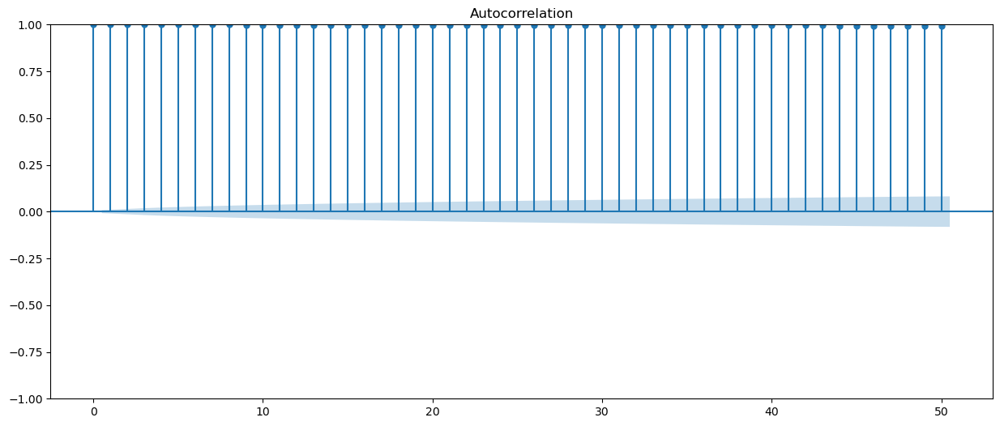

In [637]:
# Calculate autocorrelation using Matplotlib
_, ax = plt.subplots(figsize=(15, 6))
plot_acf_result = plot_acf(main_df['Weighted_Price'], lags=50, alpha=0.05, ax=ax)
lags = plot_acf_result[0]
acf_values = plot_acf_result[1]

# Convert Matplotlib figure to Plotly figure (assuming you are using Plotly)
import plotly.graph_objs as go

fig = go.Figure(go.Scatter(x=lags[1:], y=acf_values[1:], name='Autocorrelation'))
fig.update_layout(title='Autocorrelation Plot', xaxis_title='Lags', yaxis_title='Autocorrelation')

# Show the interactive plot
fig.show()


In [ ]:
# Calculate partial autocorrelation using statsmodels
pacf_values = pacf(main_df['Weighted_Price'], nlags=50)

# Create an interactive plot for Partial Autocorrelation
fig = go.Figure(go.Scatter(x=np.arange(1, 51), y=pacf_values[1:], mode='markers+lines', name='Partial Autocorrelation'))
fig.update_layout(title='Partial Autocorrelation Plot', xaxis_title='Lags', yaxis_title='Partial Autocorrelation')

# Show the interactive plot
fig.show()

### Simple Moving Average (SMA):

* **Use Case:** SMA is often used for capturing longer-term trends and smoothing out noise in the data. It provides a broader view of the overall trend in the Bitcoin price.

* **Stability:** SMA tends to be more stable and less responsive to short-term price fluctuations, making it suitable for identifying general market direction.

### Exponential Moving Average (EMA):

* **Use Case:** EMA is more responsive to recent price changes and is often used for short-term trend analysis. It can be beneficial for identifying potential reversal points and reacting quickly to market shifts.
* **Sensitivity:** EMA is sensitive to short-term movements, making it more suitable for traders and analysts looking to capture trends in a more timely manner.

##### For the "Close" column:
The "Close" price is the most common choice for calculating moving averages, and it represents the closing price of the asset at the end of a particular time period (e.g., day). Using the "Close" price is straightforward and widely adopted in financial analysis.

In [671]:
# Calculate Daily Moving Averages for Close
main_df['Daily_Close_SMA'] = main_df['Close'].rolling(window=1).mean()
main_df['Daily_Close_EMA'] = main_df['Close'].ewm(span=1, adjust=False).mean()

# Calculate Weekly Moving Averages for Close
main_df['Weekly_Close_SMA'] = main_df['Close'].rolling(window=7).mean()
main_df['Weekly_Close_EMA'] = main_df['Close'].ewm(span=7, adjust=False).mean()

# Calculate Monthly Moving Averages for Close
main_df['Monthly_Close_SMA'] = main_df['Close'].rolling(window=30).mean()
main_df['Monthly_Close_EMA'] = main_df['Close'].ewm(span=30, adjust=False).mean()

# Display the DataFrame with the new columns for Close
print(main_df[['Close', 'Daily_Close_SMA', 'Daily_Close_EMA', 'Weekly_Close_SMA', 'Weekly_Close_EMA', 'Monthly_Close_SMA', 'Monthly_Close_EMA']])

                           Close  Daily_Close_SMA  Daily_Close_EMA  \
Timestamp                                                            
2013-05-01 00:00:00   139.209831       139.209831       139.209831   
2013-05-01 01:00:00   139.591864       139.591864       139.591864   
2013-05-01 02:00:00   138.845088       138.845088       138.845088   
2013-05-01 03:00:00   133.186604       133.186604       133.186604   
2013-05-01 04:00:00   132.027500       132.027500       132.027500   
...                          ...              ...              ...   
2019-10-31 20:00:00  9203.000000      9203.000000      9203.000000   
2019-10-31 21:00:00  9133.957167      9133.957167      9133.957167   
2019-10-31 22:00:00  9138.109167      9138.109167      9138.109167   
2019-10-31 23:00:00  9147.803333      9147.803333      9147.803333   
2019-11-01 00:00:00  9158.080000      9158.080000      9158.080000   

                     Weekly_Close_SMA  Weekly_Close_EMA  Monthly_Close_SMA  \
Timestamp  

##### For the "Weighted_Price" column:

Since our dataset includes a "Weighted_Price" column, it may be useful to calculate moving averages based on this column. The "Weighted_Price" typically considers the volume of trades in addition to the price, providing a more comprehensive view of the market activity. Considering volume is an important factor in our analysis, using the "Weighted_Price" for moving averages might be beneficial.

In [672]:
# Calculate Daily Moving Averages for Weighted_Price
main_df['Daily_Weighted_Price_SMA'] = main_df['Weighted_Price'].rolling(window=1).mean()
main_df['Daily_Weighted_Price_EMA'] = main_df['Weighted_Price'].ewm(span=1, adjust=False).mean()

# Calculate Weekly Moving Averages for Weighted_Price
main_df['Weekly_Weighted_Price_SMA'] = main_df['Weighted_Price'].rolling(window=7).mean()
main_df['Weekly_Weighted_Price_EMA'] = main_df['Weighted_Price'].ewm(span=7, adjust=False).mean()

# Calculate Monthly Moving Averages for Weighted_Price
main_df['Monthly_Weighted_Price_SMA'] = main_df['Weighted_Price'].rolling(window=30).mean()
main_df['Monthly_Weighted_Price_EMA'] = main_df['Weighted_Price'].ewm(span=30, adjust=False).mean()

# Display the DataFrame with the new columns for Weighted_Price
print(main_df[['Weighted_Price', 'Daily_Weighted_Price_SMA', 'Daily_Weighted_Price_EMA', 'Weekly_Weighted_Price_SMA', 'Weekly_Weighted_Price_EMA', 'Monthly_Weighted_Price_SMA', 'Monthly_Weighted_Price_EMA']])

                     Weighted_Price  Daily_Weighted_Price_SMA  \
Timestamp                                                       
2013-05-01 00:00:00      139.372726                139.372726   
2013-05-01 01:00:00      139.626839                139.626839   
2013-05-01 02:00:00      138.976368                138.976368   
2013-05-01 03:00:00      133.271349                133.271349   
2013-05-01 04:00:00      132.063413                132.063413   
...                             ...                       ...   
2019-10-31 20:00:00     9202.440513               9202.440513   
2019-10-31 21:00:00     9133.833844               9133.833844   
2019-10-31 22:00:00     9138.168604               9138.168604   
2019-10-31 23:00:00     9148.890135               9148.890135   
2019-11-01 00:00:00     9158.080000               9158.080000   

                     Daily_Weighted_Price_EMA  Weekly_Weighted_Price_SMA  \
Timestamp                                                                  
20

In [673]:
main_df.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Daily_Close_SMA,Daily_Close_EMA,Weekly_Close_SMA,Weekly_Close_EMA,Monthly_Close_SMA,Monthly_Close_EMA,Daily_Weighted_Price_SMA,Daily_Weighted_Price_EMA,Weekly_Weighted_Price_SMA,Weekly_Weighted_Price_EMA,Monthly_Weighted_Price_SMA,Monthly_Weighted_Price_EMA
Timestamp,,,,,,,,,,,,,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726,139.209831,139.209831,NaN,139.209831,NaN,139.209831,139.372726,139.372726,NaN,139.372726,NaN,139.372726
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839,139.591864,139.591864,NaN,139.305339,NaN,139.234478,139.626839,139.626839,NaN,139.436254,NaN,139.389120
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368,138.845088,138.845088,NaN,139.190276,NaN,139.209356,138.976368,138.976368,NaN,139.321282,NaN,139.362491
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349,133.186604,133.186604,NaN,137.689358,NaN,138.820791,133.271349,133.271349,NaN,137.808799,NaN,138.969514
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413,132.027500,132.027500,NaN,136.273894,NaN,138.382514,132.063413,132.063413,NaN,136.372453,NaN,138.523959


In [676]:
main_df.isna().sum()

Open                           0
High                           0
Low                            0
Close                          0
Volume_(BTC)                   0
Volume_(Currency)              0
Weighted_Price                 0
Daily_Close_SMA                0
Daily_Close_EMA                0
Weekly_Close_SMA               6
Weekly_Close_EMA               0
Monthly_Close_SMA             29
Monthly_Close_EMA              0
Daily_Weighted_Price_SMA       0
Daily_Weighted_Price_EMA       0
Weekly_Weighted_Price_SMA      6
Weekly_Weighted_Price_EMA      0
Monthly_Weighted_Price_SMA    29
Monthly_Weighted_Price_EMA     0
dtype: int64

When we calculate the SMA using the rolling method, it requires a minimum number of data points equal to the window size to calculate the average. Here our SMA window size is 30, the first 29 values in the 'SMA' column are null because there are not enough data points to calculate the average. Starting from the 30th data point, we see valid SMA values.

I want to fill each missing SMA value with the average of the previous days(cumulative mean)

In [679]:
# Columns containing SMA values and their corresponding original columns
sma_columns = ['Daily_Close_SMA', 'Weekly_Close_SMA', 'Monthly_Close_SMA', 'Daily_Weighted_Price_SMA', 'Weekly_Weighted_Price_SMA', 'Monthly_Weighted_Price_SMA']
original_columns = ['Close', 'Weighted_Price']

# Calculate cumulative mean for each original column
cumulative_mean_close = main_df[original_columns[0]].expanding().mean()
cumulative_mean_weighted_price = main_df[original_columns[1]].expanding().mean()

# Fill NaN values in SMA columns using cumulative mean of the corresponding original columns
main_df[sma_columns] = main_df[sma_columns].apply(lambda col: col.combine_first(cumulative_mean_close) if 'Close' in col.name else col.combine_first(cumulative_mean_weighted_price))
    
# updated DataFrame/ sanity check if all the missing values have been replaced
main_df.head(31)

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Daily_Close_SMA,Daily_Close_EMA,Weekly_Close_SMA,Weekly_Close_EMA,Monthly_Close_SMA,Monthly_Close_EMA,Daily_Weighted_Price_SMA,Daily_Weighted_Price_EMA,Weekly_Weighted_Price_SMA,Weekly_Weighted_Price_EMA,Monthly_Weighted_Price_SMA,Monthly_Weighted_Price_EMA
Timestamp,,,,,,,,,,,,,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726,139.209831,139.209831,139.209831,139.209831,139.209831,139.209831,139.372726,139.372726,139.372726,139.372726,139.372726,139.372726
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839,139.591864,139.591864,139.400847,139.305339,139.400847,139.234478,139.626839,139.626839,139.499782,139.436254,139.499782,139.389120
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368,138.845088,138.845088,139.215594,139.190276,139.215594,139.209356,138.976368,138.976368,139.325311,139.321282,139.325311,139.362491
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349,133.186604,133.186604,137.708347,137.689358,137.708347,138.820791,133.271349,133.271349,137.811820,137.808799,137.811820,138.969514
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413,132.027500,132.027500,136.572177,136.273894,136.572177,138.382514,132.063413,132.063413,136.662139,136.372453,136.662139,138.523959
2013-05-01 05:00:00,134.744314,134.797255,134.436078,134.555294,4.199986,565.054974,134.634019,134.555294,134.555294,136.236030,135.844244,136.236030,138.135597,134.634019,134.634019,136.324119,135.937844,136.324119,138.272995
2013-05-01 06:00:00,135.107736,135.213019,134.453585,134.498302,5.266858,708.609600,134.833989,134.498302,134.498302,135.987783,135.507758,135.987783,137.900933,134.833989,134.833989,136.111243,135.661880,136.111243,138.051124
2013-05-01 07:00:00,133.370893,133.465893,133.120179,133.266071,5.062889,672.879158,133.273026,133.266071,133.266071,135.138675,134.947337,135.647569,137.601909,133.273026,133.273026,135.239858,135.064667,135.756466,137.742859
2013-05-01 08:00:00,131.984182,132.122727,131.704000,131.876909,10.861710,1423.069374,131.893583,131.876909,131.876909,134.036538,134.179730,135.228607,137.232555,131.893583,131.893583,134.135107,134.271896,135.327257,137.365487


#### Relative Strength Index (RSI):

Measures the magnitude of recent price changes to identify overbought or oversold conditions.

In [681]:
# Relative Strength Index (RSI)
delta = main_df['Close'].diff()
gain = delta.where(delta > 0, 0)
loss = -delta.where(delta < 0, 0)

avg_gain = gain.rolling(window=14).mean()
avg_loss = loss.rolling(window=14).mean()

rs = avg_gain / avg_loss
main_df['RSI'] = 100 - (100 / (1 + rs))
main_df.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Daily_Close_SMA,Daily_Close_EMA,Weekly_Close_SMA,Weekly_Close_EMA,Monthly_Close_SMA,Monthly_Close_EMA,Daily_Weighted_Price_SMA,Daily_Weighted_Price_EMA,Weekly_Weighted_Price_SMA,Weekly_Weighted_Price_EMA,Monthly_Weighted_Price_SMA,Monthly_Weighted_Price_EMA,RSI
Timestamp,,,,,,,,,,,,,,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726,139.209831,139.209831,139.209831,139.209831,139.209831,139.209831,139.372726,139.372726,139.372726,139.372726,139.372726,139.372726,NaN
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839,139.591864,139.591864,139.400847,139.305339,139.400847,139.234478,139.626839,139.626839,139.499782,139.436254,139.499782,139.389120,NaN
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368,138.845088,138.845088,139.215594,139.190276,139.215594,139.209356,138.976368,138.976368,139.325311,139.321282,139.325311,139.362491,NaN
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349,133.186604,133.186604,137.708347,137.689358,137.708347,138.820791,133.271349,133.271349,137.811820,137.808799,137.811820,138.969514,NaN
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413,132.027500,132.027500,136.572177,136.273894,136.572177,138.382514,132.063413,132.063413,136.662139,136.372453,136.662139,138.523959,NaN


#### Moving Average Convergence Divergence (MACD):

Shows the relationship between two moving averages and helps identify changes in momentum.

In [682]:
# Moving Average Convergence Divergence (MACD)
main_df['MACD'] = main_df['Close'].ewm(span=12, adjust=False).mean() - main_df['Close'].ewm(span=26, adjust=False).mean()
main_df['Signal_Line'] = main_df['MACD'].ewm(span=9, adjust=False).mean()
main_df.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Daily_Close_SMA,Daily_Close_EMA,Weekly_Close_SMA,...,Monthly_Close_EMA,Daily_Weighted_Price_SMA,Daily_Weighted_Price_EMA,Weekly_Weighted_Price_SMA,Weekly_Weighted_Price_EMA,Monthly_Weighted_Price_SMA,Monthly_Weighted_Price_EMA,RSI,MACD,Signal_Line
Timestamp,,,,,,,,,,,,,,,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726,139.209831,139.209831,139.209831,...,139.209831,139.372726,139.372726,139.372726,139.372726,139.372726,139.372726,NaN,0.000000,0.000000
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839,139.591864,139.591864,139.400847,...,139.234478,139.626839,139.626839,139.499782,139.436254,139.499782,139.389120,NaN,0.030476,0.006095
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368,138.845088,138.845088,139.215594,...,139.209356,138.976368,138.976368,139.325311,139.321282,139.325311,139.362491,NaN,-0.005567,0.003763
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349,133.186604,133.186604,137.708347,...,138.820791,133.271349,133.271349,137.811820,137.808799,137.811820,138.969514,NaN,-0.485131,-0.094016
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413,132.027500,132.027500,136.572177,...,138.382514,132.063413,132.063413,136.662139,136.372453,136.662139,138.523959,NaN,-0.947793,-0.264771


#### Bollinger Bands:

Consists of a middle band (SMA), an upper band at K times the standard deviation above the middle band, and a lower band at K times the standard deviation below the middle band. Useful for identifying volatility and potential price reversal points.

In [684]:
window = 20  # Adjust the window size as needed
main_df['Rolling_Mean'] = main_df['Close'].rolling(window=window).mean()
main_df['Upper_Band'] = main_df['Rolling_Mean'] + 2 * main_df['Close'].rolling(window=window).std()
main_df['Lower_Band'] = main_df['Rolling_Mean'] - 2 * main_df['Close'].rolling(window=window).std()

main_df.head(35)


,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Daily_Close_SMA,Daily_Close_EMA,Weekly_Close_SMA,...,Weekly_Weighted_Price_SMA,Weekly_Weighted_Price_EMA,Monthly_Weighted_Price_SMA,Monthly_Weighted_Price_EMA,RSI,MACD,Signal_Line,Rolling_Mean,Upper_Band,Lower_Band
Timestamp,,,,,,,,,,,,,,,,,,,,,
2013-05-01 00:00:00,139.490847,139.527627,139.193559,139.209831,1.858204,258.547425,139.372726,139.209831,139.209831,139.209831,...,139.372726,139.372726,139.372726,139.372726,NaN,0.000000,0.000000,NaN,NaN,NaN
2013-05-01 01:00:00,139.710339,139.773898,139.551356,139.591864,4.539084,631.778550,139.626839,139.591864,139.591864,139.400847,...,139.499782,139.436254,139.499782,139.389120,NaN,0.030476,0.006095,NaN,NaN,NaN
2013-05-01 02:00:00,139.132632,139.157368,138.820000,138.845088,2.319432,321.934717,138.976368,138.845088,138.845088,139.215594,...,139.325311,139.321282,139.325311,139.362491,NaN,-0.005567,0.003763,NaN,NaN,NaN
2013-05-01 03:00:00,133.417547,133.563396,133.090943,133.186604,22.198751,2948.115070,133.271349,133.186604,133.186604,137.708347,...,137.811820,137.808799,137.811820,138.969514,NaN,-0.485131,-0.094016,NaN,NaN,NaN
2013-05-01 04:00:00,132.180833,132.358542,131.845625,132.027500,7.479716,987.320421,132.063413,132.027500,132.027500,136.572177,...,136.662139,136.372453,136.662139,138.523959,NaN,-0.947793,-0.264771,NaN,NaN,NaN
2013-05-01 05:00:00,134.744314,134.797255,134.436078,134.555294,4.199986,565.054974,134.634019,134.555294,134.555294,136.236030,...,136.324119,135.937844,136.324119,138.272995,NaN,-1.097829,-0.431383,NaN,NaN,NaN
2013-05-01 06:00:00,135.107736,135.213019,134.453585,134.498302,5.266858,708.609600,134.833989,134.498302,134.498302,135.987783,...,136.111243,135.661880,136.111243,138.051124,NaN,-1.207414,-0.586589,NaN,NaN,NaN
2013-05-01 07:00:00,133.370893,133.465893,133.120179,133.266071,5.062889,672.879158,133.273026,133.266071,133.266071,135.138675,...,135.239858,135.064667,135.756466,137.742859,NaN,-1.377810,-0.744833,NaN,NaN,NaN
2013-05-01 08:00:00,131.984182,132.122727,131.704000,131.876909,10.861710,1423.069374,131.893583,131.876909,131.876909,134.036538,...,134.135107,134.271896,135.327257,137.365487,NaN,-1.606425,-0.917152,NaN,NaN,NaN


#### Average True Range (ATR):

Measures market volatility by calculating the average range between high and low prices over a specified period.

In [ ]:
# Average True Range (ATR)
df['TR'] = df[['High', 'Close']].max(axis=1) - df[['Low', 'Close']].min(axis=1)
df['ATR'] = df['TR'].rolling(window=14).mean()

main_df.head()

#### On-Balance Volume (OBV):

Cumulative indicator that adds volume on up days and subtracts volume on down days. Provides insights into the strength of a price trend.

In [ ]:
# On-Balance Volume (OBV)
df['OBV'] = (df['Volume_(BTC)'] * ((df['Close'] - df['Low']) - (df['High'] - df['Close'])) / (df['High'] - df['Low'])).cumsum()

main_df.head()

#### Stochastic Oscillator:

Measures the location of a closing price relative to its price range over a given period. Helpful for identifying potential reversal points.

In [ ]:
# Stochastic Oscillator
k_period = 14  # Adjust the period as needed
df['Stochastic_Oscillator'] = (df['Close'] - df['Low'].rolling(window=k_period).min()) / (df['High'].rolling(window=k_period).max() - df['Low'].rolling(window=k_period).min())

main_df.head()

#### Volume Weighted Moving Average (VWMA):

Similar to the SMA but weighted by volume, providing a more accurate representation of average prices.

In [ ]:

# Volume Weighted Moving Average (VWMA)
df['VWMA'] = (df['Volume_(Currency)'] * df['Close']).rolling(window=20).sum() / df['Volume_(Currency)'].rolling(window=20).sum()

main_df.head()